# Loading the data

## Imports and Google Drive mounting

In [1]:

try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
  pass

# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras

print(tf.__version__)

# Helper libraries
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import sklearn as sk
import pandas as pd
from pandas import read_csv
from datetime import datetime
import math
import os

# fix random seed for reproducibility
seed = 2020
np.random.seed(seed)

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error

from tensorflow.keras.datasets import cifar100
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, BatchNormalization, Activation
from tensorflow.keras.layers import Conv1D, MaxPooling1D, GlobalMaxPooling1D
from tensorflow.keras.layers import LSTM, GRU
from tensorflow.keras.regularizers import L1L2
from tensorflow.keras.constraints import max_norm
from tensorflow.keras.optimizers import Adam, SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.models import load_model
from tensorflow.keras import optimizers
from tensorflow.keras import Input
from tensorflow.keras.models import Model
from tensorflow.keras.constraints import MaxNorm

TensorFlow 2.x selected.
2.1.0


In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

!ls '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/'

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
checkpoints			 preprocessed_train_data_all.csv
pollution_data.csv		 preprocessed_train_data.csv
preprocessed_pollution_data.csv  preprocessed_val_data.csv
preprocessed_test_data.csv


## Loading the dataset

/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:313: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  if not layout[ax.rowNum + 1, ax.colNum]:
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:3

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f3290398438>,
      dtype=object)

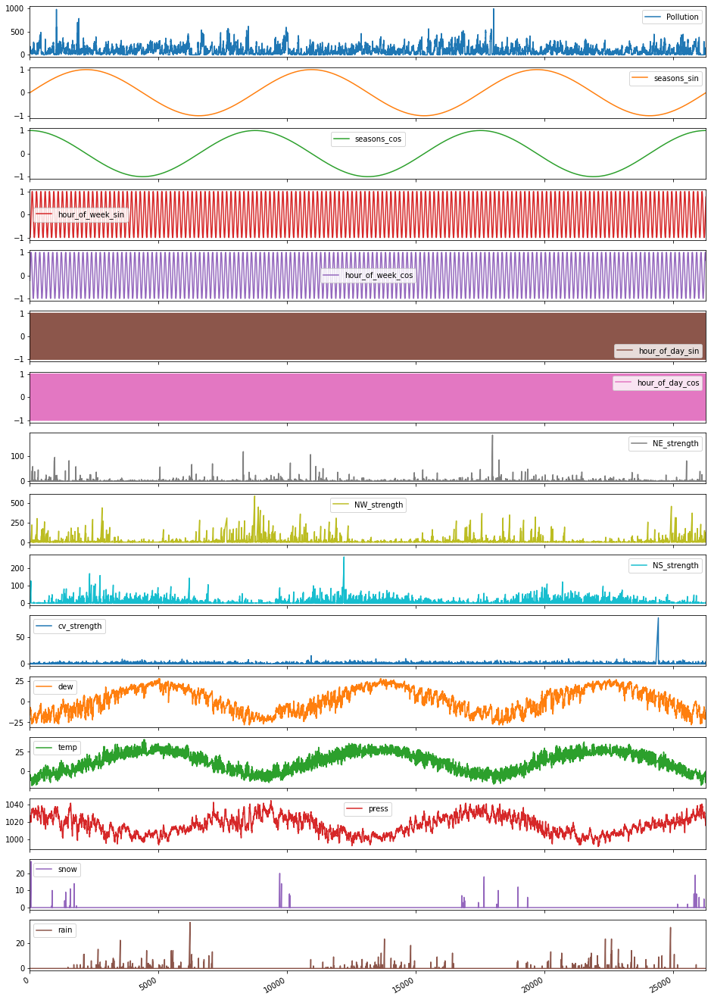

In [3]:
# this code only loads train and test datasets

# remember you also need to split off a validation dataset
# either by reusing and adapting the splitting code from the preprocessing notebook 
# or by writing your own code
# like in the previous assignments, this means you should have 4 sets:

# train_all (train+validate), train, validate and test

# The PATH setting below assumes you just uploaded the data file to your Colab session
# When using Drive: replace this by the path where you put the data file
DATAPATH = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/'
TRAINDATAALLFILE = DATAPATH+'preprocessed_train_data_all.csv'
TRAINDATAFILE = DATAPATH+'preprocessed_train_data.csv'
VALDATAFILE = DATAPATH+'preprocessed_val_data.csv'
TESTDATAFILE = DATAPATH+'preprocessed_test_data.csv'

train_all_dataset = read_csv(TRAINDATAALLFILE, header=0, index_col=0)
train_dataset = read_csv(TRAINDATAFILE, header=0, index_col=0)
val_dataset = read_csv(VALDATAFILE, header=0, index_col=0)
test_dataset = read_csv(TESTDATAFILE, header=0, index_col=0)

#check - note that you can make many other plots directly from pandas dataframes:
# https://pandas.pydata.org/pandas-docs/version/0.16/visualization.html
train_dataset.loc[:, train_dataset.columns != 'Year'].plot(subplots=True,figsize=(16,26))

## Extract train, validate and test features and labels

In [0]:
# extract data from dataframes, selecting the features you want
# note that the labels simply contain the pollution data for now
# depending on the window sizes used in training, the correct values will be cut out
features = np.arange(1,17)
pollution = 1

# Important: Tensorflow 2.x gives an error if you omit
# the np.asarray(...,,dtype=np.float32)
train_all_values = np.asarray(train_all_dataset.values[:,features],dtype=np.float32)
train_all_labels = np.asarray(train_all_dataset.values[:,pollution],dtype=np.float32)
train_values = np.asarray(train_dataset.values[:,features],dtype=np.float32)
train_labels = np.asarray(train_dataset.values[:,pollution],dtype=np.float32)
val_values = np.asarray(val_dataset.values[:,features],dtype=np.float32)
val_labels = np.asarray(val_dataset.values[:,pollution],dtype=np.float32)
test_values = np.asarray(test_dataset.values[:,features],dtype=np.float32)
test_labels = np.asarray(test_dataset.values[:,pollution],dtype=np.float32)

## Normalising the data


/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:195: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The rowNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().rowspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:307: MatplotlibDeprecationWarning: 
The colNum attribute was deprecated in Matplotlib 3.2 and will be removed two minor releases later. Use ax.get_subplotspec().colspan.start instead.
  layout[ax.rowNum, ax.colNum] = ax.get_visible()
/usr/local/lib/python3.6/dist-packages/pandas/plotting/_matplotlib/tools.py:313: Matpl

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f328f961198>,
      dtype=object)

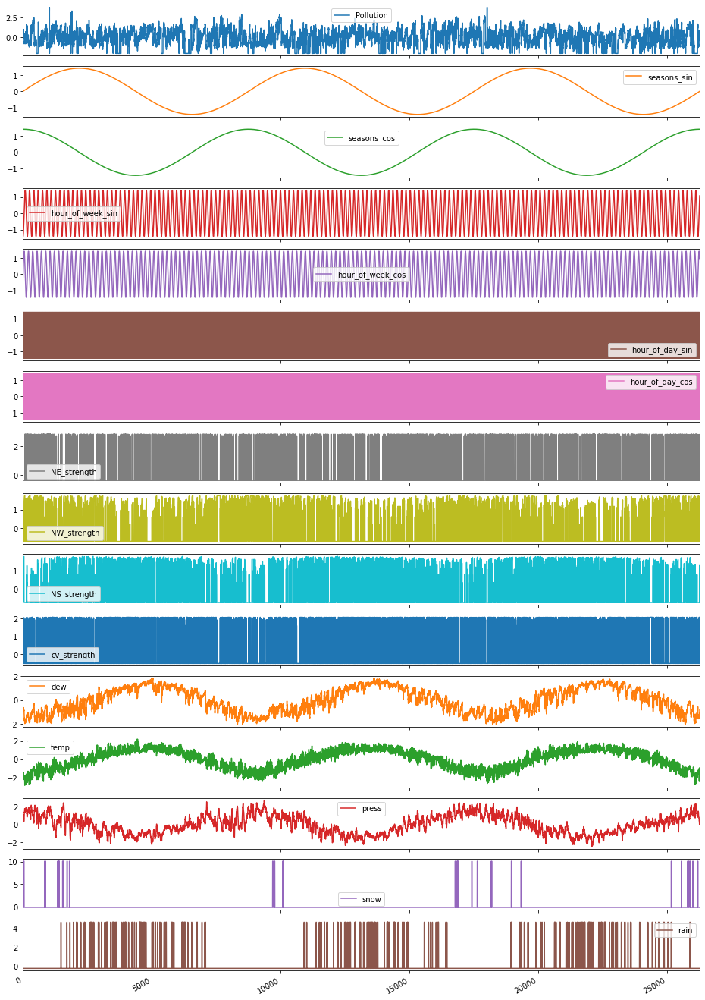

In [5]:
# imports to show that there are many different scalers
# especially with recurrent NNs, the choice of scaler can make a difference
# look up what they do before choosing which one to try
# from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import MinMaxScaler
# from sklearn.preprocessing import MaxAbsScaler
# from sklearn.preprocessing import RobustScaler
# from sklearn.preprocessing import Normalizer # BAD for this case
# from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PowerTransformer # BEST for this case

# Example: train standard scalers, apply to train and test data
# adapt to do all you need to do ...
SS1 = PowerTransformer()
SS1.fit(train_values)

train_scaled = SS1.transform(train_values)
val_scaled = SS1.transform(val_values)

SS2 = PowerTransformer()
SS2.fit(train_all_values)

train_all_scaled = SS2.transform(train_all_values)
test_scaled = SS2.transform(test_values)

pd.DataFrame(train_scaled, columns=train_dataset.columns[1:]).plot(subplots=True,figsize=(16,26))

## Dataset manipulations

In [0]:
# dense network:
# here you only need to take into account that we are predicting 6 steps ahead
# this means that the features of the first timestep (index 0)
# are used to predict the 7th pollution value (index 6) so the first 6 and the last 6 feature-samples labels are omitted
def create_dataset_dense(train, test, ahead=6): # can use this with different 'ahead' values, but default is set to 6
    return train[:-ahead,:], test[ahead:]

# window-based and recurrent networks:
# now, you use a window of k history values to predict
# this means that the features of the first k timesteps (indices 0 to k-1)
# are used to predict the k+6th pollution value (index k+6-1)
# output dimension of train data is samples x window x features
def create_dataset_windowed(train, test, ahead=6, window_size=1):
  samples = train.shape[0]-ahead-(window_size-1) 
  dataX= []
  for i in range(samples):
      a = train[i:(i+window_size), :]
      dataX.append(a)
  
  return np.array(dataX), test[ahead+window_size-1:]

# reshape arrays so that they can be used as input for the top model of the ensemble
def create_dataset_top(train, test, ahead=6, window_size=1):
  return np.concatenate(train, axis=1), test[ahead+window_size-1:]

## Help functions for visualization

In [0]:
def plot_history(history):
  plt.figure(figsize=(6,4))
  
  plt.xlabel('Epoch')
  plt.ylabel('Mae')
  plt.plot(history.epoch, np.array(history.history['mae']),'g-',
           label='Train MAE')
  try:
    plt.plot(history.epoch, np.array(history.history['val_mae']),'r-',
             label = 'Validation MAE')
  except:
    pass
  plt.legend()
  plt.show()

def PlotResults(labels,predictions,binsize=10):
  num_samples = len(labels)
  
  fig = plt.figure(figsize=(16,16))
  spec = gridspec.GridSpec(ncols=4, nrows=4, figure=fig)
  ax1 = fig.add_subplot(spec[0, :])
  ax2 = fig.add_subplot(spec[1, :])
  ax3 = fig.add_subplot(spec[2:,0:2])
  ax4 = fig.add_subplot(spec[2:,2:])
  
  ax1.plot(labels,'k-',label='Labels')
  ax1.plot(predictions,'r-',label='Predictions')
  ax1.set_ylabel('Pollution')
  ax1.legend()
  
  errors=np.absolute(labels-predictions)
  ax2.plot(errors,'k-')
  ax2.set_ylabel("Absolute error")
  
  ax3.scatter(labels,predictions)
  ax3.set_xlabel('Labels')
  ax3.set_ylabel('Predictions')

  bins = np.arange(0,(np.ceil(np.max(errors)/binsize)+1)*binsize,binsize)
  
  ax4.hist(errors,bins=bins)
  ax4.set_xlabel('Absolute error')
  ax4.set_ylabel('Frequency')

  plt.show()

# Step 1

In [0]:
X_train_d,r_train_d = create_dataset_dense(train_scaled,train_labels)
X_val_d,r_val_d = create_dataset_dense(val_scaled,val_labels)
X_train_all_d,r_train_all_d = create_dataset_dense(train_all_scaled,train_all_labels)
X_test_d,r_test_d = create_dataset_dense(test_scaled,test_labels)

# Train a Dense network on the scaled features
def dense_model(learning_rate=0.01, hidden=[256,1024,1024,128], dropouts=[0.5,0.5,0.5,0.1]):
  # create linear model
  model = Sequential()
  model.add(Dense(hidden[0], kernel_initializer='he_uniform', input_shape=(train_scaled.shape[1],)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(Dropout(dropouts[0]))

  for idx in range(1, len(hidden)):
    model.add(Dense(hidden[idx], kernel_initializer='he_uniform'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(Dropout(dropouts[idx]))
  
  model.add(Dense(1))
  model.add(Activation('linear'))
  # no dropout at the end
  
  optim = tf.keras.optimizers.Adam(lr=learning_rate)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])
  return model

In [9]:
model = dense_model()
model.summary()

batch_size = 5*168
epochs = 70

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_1/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)
# lr_callback = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_mae',
#                                                    factor=0.9,
#                                                    patience=5,
#                                                    verbose=1,
#                                                    min_lr=0.0001)

# history = model.fit(X_train_d,
#                     r_train_d,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_d,r_val_d),
#                     callbacks=[cp_callback, lr_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_d,
                    r_train_all_d,
                    shuffle=True,
                    batch_size=batch_size,
                    epochs=epochs)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 256)               4352      
_________________________________________________________________
batch_normalization (BatchNo (None, 256)               1024      
_________________________________________________________________
activation (Activation)      (None, 256)               0         
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 1024)              263168    
_________________________________________________________________
batch_normalization_1 (Batch (None, 1024)              4096      
_________________________________________________________________
activation_1 (Activation)    (None, 1024)              0

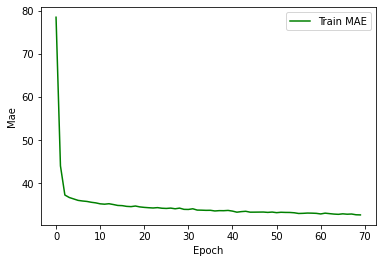

train      mae: 30.360923767089844
validation mae: 34.866722106933594


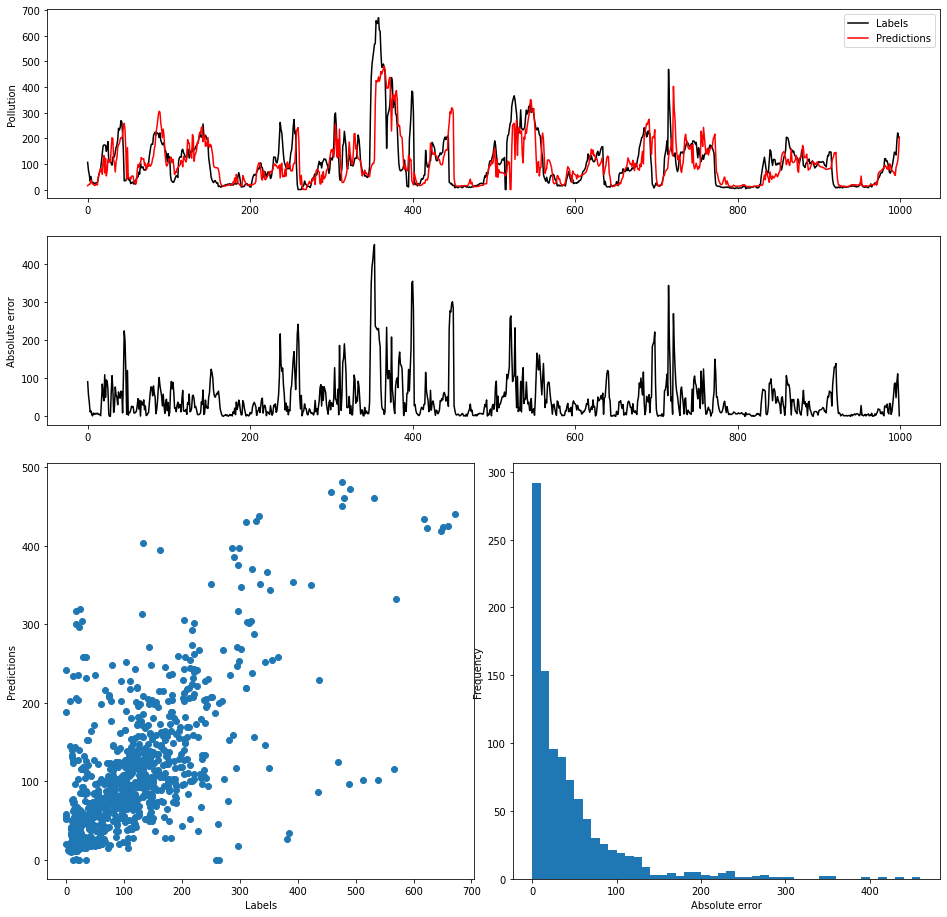

In [10]:
plot_history(history)

# y_train = model.predict(X_train_d)
# y_val = model.predict(X_val_d)
y_train_all = model.predict(X_train_all_d)
y_test = model.predict(X_test_d)

# mae_train = mean_absolute_error(r_train_d,y_train)
# mae_val = mean_absolute_error(r_val_d,y_val)
mae_train_all = mean_absolute_error(r_train_all_d,y_train_all)
mae_test = mean_absolute_error(r_test_d,y_test)

# print(f"train      mae: {mae_train_all}")
# print(f"test mae: {mae_test}")
print(f"train      mae: {mae_train_all}")
print(f"validation mae: {mae_test}")

# Visualise first 1000 predictions for validation and test
# PlotResults(r_val_d[:1000],y_val[:1000,0])
PlotResults(r_test_d[:1000],y_test[:1000,0])

## LIME

In [11]:
# predictions = model.predict(X_val_d)
# r_val_d_T = np.transpose(np.array([r_val_d]))
# mae_val = abs(r_val_d_T-predictions)
# mae_val_partitioned = np.argpartition(mae_val,-5,axis=0)
# largest = mae_val_partitioned[-5:]
# smallest = mae_val_partitioned[:5]
# print(f'Largest mistakes: {mae_val[largest]}')
# print(f'Smallest mistakes: {mae_val[smallest]}')

predictions = model.predict(X_test_d)
r_test_d_T = np.transpose(np.array([r_test_d]))
mae_test = abs(r_test_d_T-predictions)
mae_test_partitioned = np.argpartition(mae_test,-5,axis=0)
largest = mae_test_partitioned[-5:]
smallest = mae_test_partitioned[:5]
print(f'Largest mistakes: {mae_test[largest]}')
print(f'Smallest mistakes: {mae_test[smallest]}')

Largest mistakes: [[[419.20596]]

 [[451.2628 ]]

 [[516.565  ]]

 [[437.78207]]

 [[460.53723]]]
Smallest mistakes: [[[ 4.7851257]]

 [[ 3.4017372]]

 [[ 8.788279 ]]

 [[12.0851345]]

 [[12.711214 ]]]


In [12]:
!pip install lime

import lime
import lime.lime_tabular

feature_names = ['Pollution',
                 'seasons_sin',
                 'seasons_cos',
                 'hour_of_week_sin',
                 'hour_of_week_cos',
                 'hour_of_day_sin',
                 'hour_of_day_cos',
                 'NE_strength',
                 'NW_strength',
                 'SE_strength',
                 'cv_strength',
                 'dew',
                 'temp',
                 'press',
                 'snow',
                 'rain']

explainer = lime.lime_tabular.LimeTabularExplainer(train_scaled, feature_names=feature_names, class_names=['Pollution'], verbose=True, mode='regression')

In [13]:
# Explain largest and smallest mistakes
print('Largest mistakes:')
for i in largest:
  print(f'Correct pollution: {r_val_d[i]}')
  exp = explainer.explain_instance(X_val_d[i[0]], model.predict, num_features=5, num_samples=5000)
  exp.show_in_notebook(show_table=False)
  exp.score

print('Smallest mistakes:')
for i in smallest:
  print(f'Correct pollution: {r_val_d[i]}')
  exp = explainer.explain_instance(X_val_d[i[0]], model.predict, num_features=5, num_samples=5000)
  exp.show_in_notebook(show_table=False)
  exp.score

Largest mistakes:
Correct pollution: [289.]
Intercept -9.073544251839309
Prediction_local [91.86833571]
Right: 266.85614


Correct pollution: [227.]
Intercept 10.458152778999157
Prediction_local [111.73522731]
Right: 164.46582


Correct pollution: [14.]
Intercept 56.26142526155941
Prediction_local [-15.80824271]
Right: 18.795448


Correct pollution: [201.]
Intercept 9.095140395595095
Prediction_local [87.39353018]
Right: 177.33276


Correct pollution: [370.]
Intercept -9.622402032133586
Prediction_local [99.93343762]
Right: 290.445


Smallest mistakes:
Correct pollution: [59.]
Intercept 28.656407253076047
Prediction_local [30.40274477]
Right: 64.03888


Correct pollution: [23.]
Intercept 49.04832864562894
Prediction_local [-16.13255713]
Right: 59.256817


Correct pollution: [20.]
Intercept 56.931562378563356
Prediction_local [-16.65907207]
Right: 50.335754


Correct pollution: [14.]
Intercept 48.11350116855321
Prediction_local [-3.73077516]
Right: 24.017387


Correct pollution: [23.]
Intercept 41.12963793365804
Prediction_local [-19.58710775]
Right: 52.57672


# Step 2

## Window-based CNN

In [0]:
# current code for pollution-only, add other features for multi-feature model, 
# remove indices as in commented code if you want to use all features
train_features = [0,]

CNN_WINDOW_SIZE = 168
ahead = 6

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

def conv_model(CNN_WINDOW_SIZE=24, learning_rate=0.01, hidden=[64,128,256]):
  model = Sequential()
  
  model.add(Conv1D(filters=hidden[0],
                      kernel_size=2,
                      padding='same',
                      kernel_initializer='he_uniform',
                      input_shape=(CNN_WINDOW_SIZE,len(train_features))))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling1D(pool_size=2))

  for idx in range(1, len(hidden)):
    model.add(Conv1D(filters=hidden[idx],
                        kernel_size=2,
                        padding='same',
                        kernel_initializer='he_uniform'))
    model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(MaxPooling1D(pool_size=2))

  model.add(Flatten())
  model.add(Dense(1, kernel_initializer='glorot_uniform'))
  model.add(Activation('linear'))

  optim = tf.keras.optimizers.Adam(lr=learning_rate)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])

  return model

In [15]:
batch_size = 8*168 # 8 weeks
epochs = 30
learning_rate = 0.001

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[64,128,256])
model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_2/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w,
                    r_train_all_w,
                    shuffle=True,
                    batch_size=batch_size,
                    epochs=epochs)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 168, 64)           192       
_________________________________________________________________
batch_normalization_4 (Batch (None, 168, 64)           256       
_________________________________________________________________
activation_5 (Activation)    (None, 168, 64)           0         
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 84, 64)            0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 84, 128)           16512     
_________________________________________________________________
batch_normalization_5 (Batch (None, 84, 128)           512       
_________________________________________________________________
activation_6 (Activation)    (None, 84, 128)          

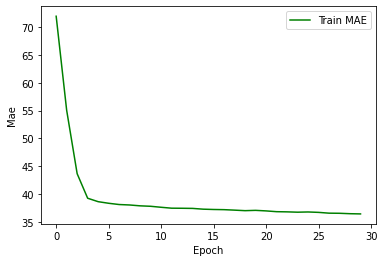

train all mae: 36.263267517089844
test      mae: 36.93035888671875


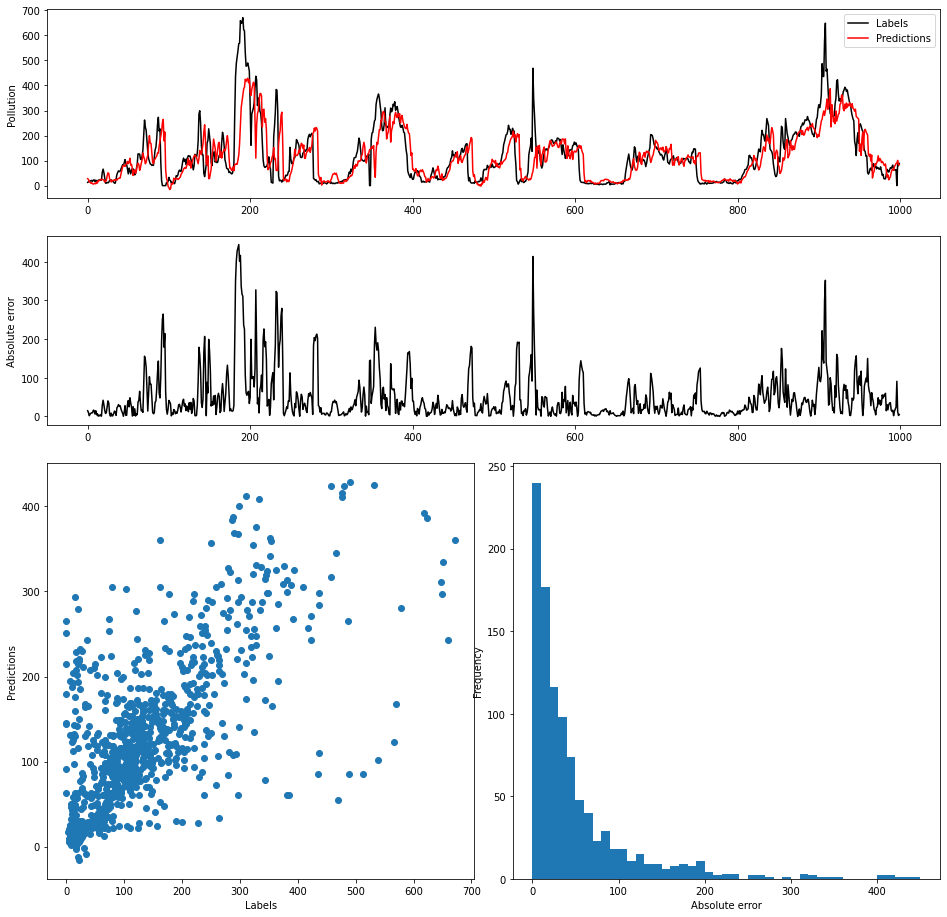

In [16]:
plot_history(history)

# y_train = model.predict(X_train_w)
# y_val = model.predict(X_val_w)
y_train_all = model.predict(X_train_all_w)
y_test = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train)
# mae_val = mean_absolute_error(r_val_w,y_val)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all)
mae_test = mean_absolute_error(r_test_w,y_test)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

# Visualise first 1000 predictions for validation and test
# PlotResults(r_val_w[:1000],y_val[:1000,0])
PlotResults(r_test_w[:1000],y_test[:1000,0])

## LSTM/GRU

In [0]:
# current code for pollution-only, add other features for multi-feature model, 
# remove indices as in commented code if you want to use all features
train_features = [0,]

GRU_WINDOW_SIZE = 20
ahead = 6

# For GRU, input has to be between 0 and 1
# max_value_train = np.max(train_scaled[:,train_features])
# min_value_train = np.min(train_scaled[:,train_features])
# max_value_val = np.max(val_scaled[:,train_features])
# min_value_val = np.min(val_scaled[:,train_features])
max_value_train_all = np.max(train_all_scaled[:,train_features])
min_value_train_all = np.min(train_all_scaled[:,train_features])
max_value_test = np.max(test_scaled[:,train_features])
min_value_test = np.min(test_scaled[:,train_features])

# train_scaled_gru = (train_scaled[:,train_features]-min_value_train)/(max_value_train-min_value_train)
# val_scaled_gru = (val_scaled[:,train_features]-min_value_val)/(max_value_val-min_value_val)
train_all_scaled_gru = (train_all_scaled[:,train_features]-min_value_train_all)/(max_value_train_all-min_value_train_all)
test_scaled_gru = (test_scaled[:,train_features]-min_value_test)/(max_value_test-min_value_test)

# X_train_gru,r_train_gru = create_dataset_windowed(train_scaled_gru, train_labels, window_size=GRU_WINDOW_SIZE)
# X_val_gru,r_val_gru = create_dataset_windowed(val_scaled_gru, val_labels, window_size=GRU_WINDOW_SIZE)
X_train_all_gru,r_train_all_gru = create_dataset_windowed(train_all_scaled_gru, train_all_labels, window_size=GRU_WINDOW_SIZE)
X_test_gru,r_test_gru = create_dataset_windowed(test_scaled_gru, test_labels, window_size=GRU_WINDOW_SIZE)

def gru_model(GRU_WINDOW_SIZE=24, units=512, learning_rate=0.001):
  model = Sequential()
    
  model.add(GRU(units=units,
                return_sequences=False,
                implementation=1,
                input_shape=(GRU_WINDOW_SIZE,1)))
  model.add(Dropout(0.5))
  model.add(Dense(1))
  model.add(Activation('linear'))

  optim = tf.keras.optimizers.SGD(learning_rate=learning_rate,momentum=0.9,clipnorm=9)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])
  return model

In [18]:
batch_size = 2*168
epochs = 50
learning_rate = 0.01

model = gru_model(GRU_WINDOW_SIZE=GRU_WINDOW_SIZE, units=512, learning_rate=learning_rate)
model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_2/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)
# es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_mae',
#                                                min_delta=0.0001,
#                                                patience=5)
# history = model.fit(X_train_gru,
#                     r_train_gru,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_gru,r_val_gru),
#                     callbacks=[cp_callback, es_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_gru,
                    r_train_all_gru,
                    shuffle=True,
                    batch_size=batch_size,
                    epochs=epochs)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
gru (GRU)                    (None, 512)               791040    
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 513       
_________________________________________________________________
activation_9 (Activation)    (None, 1)                 0         
Total params: 791,553
Trainable params: 791,553
Non-trainable params: 0
_________________________________________________________________
Train on 35015 samples
Epoch 1/50
35015/35015 [==============================] - 2s 69us/sample - loss: 71.2187 - mse: 10740.4189 - mae: 71.2187
Epoch 2/50
35015/35015 [==============================] - 1s 42us/sample - loss: 65.6855 - mse: 9135.

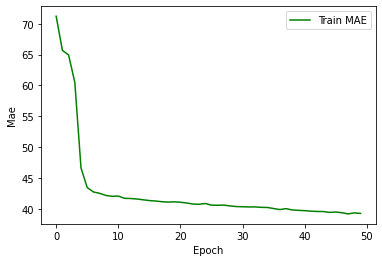

train      mae: 38.36615753173828
test mae: 49.90842056274414


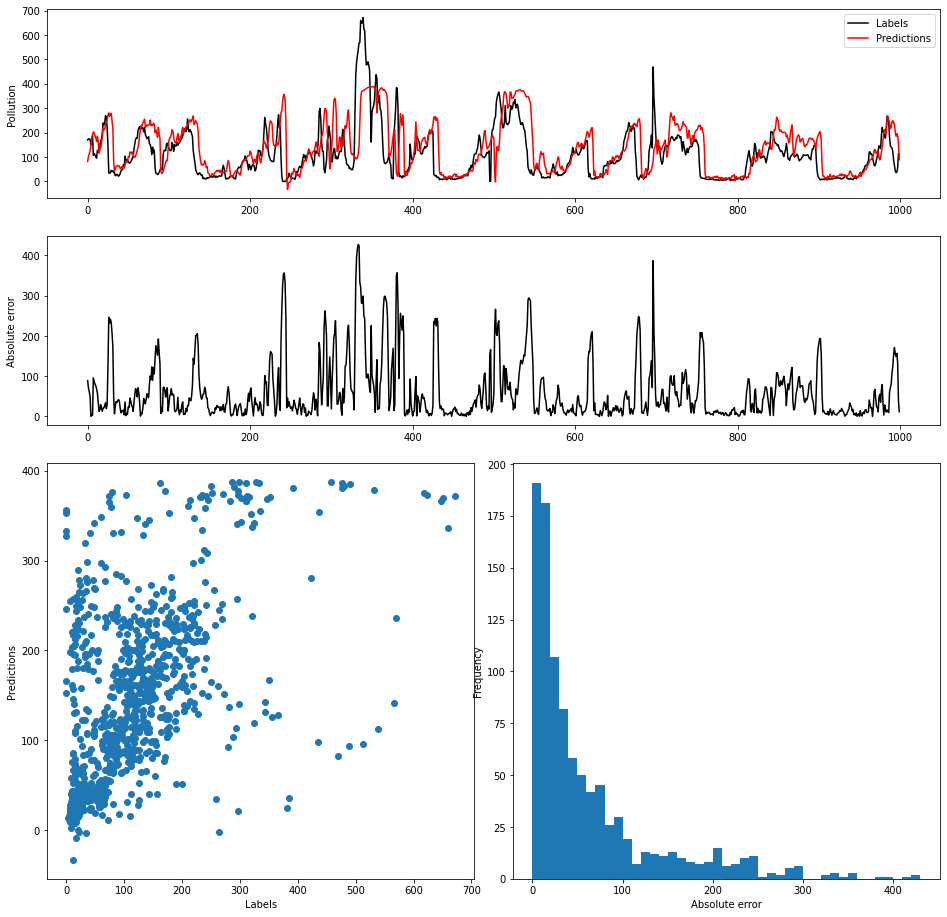

In [19]:
plot_history(history)

# y_train = model.predict(X_train_gru)
# y_val = model.predict(X_val_gru)
y_train_all = model.predict(X_train_all_gru)
y_test = model.predict(X_test_gru)

# mae_train = mean_absolute_error(r_train_gru,y_train)
# mae_val = mean_absolute_error(r_val_gru,y_val)
mae_train_all = mean_absolute_error(r_train_all_gru,y_train_all)
mae_test = mean_absolute_error(r_test_gru,y_test)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train      mae: {mae_train_all}")
print(f"test mae: {mae_test}")

# Visualise first 1000 predictions for validation and test
# PlotResults(r_val_gru[:1000],y_val[:1000,0])
PlotResults(r_test_gru[:1000],y_test[:1000,0])

# Step 3

In [0]:
# current code for pollution-only, add other features for multi-feature model, 
# remove indices as in commented code if you want to use all features
train_features = np.arange(14) # 16: all, 14: without snow and rain, 13: also leave pressure out, 12: also leave temperature out

CNN_WINDOW_SIZE = 2*168 # 2 weeks
ahead = 6

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

def conv_model(CNN_WINDOW_SIZE=24, learning_rate=0.01, hidden=[32,64,128,256]):
  model = Sequential()

  model.add(Conv1D(filters=hidden[0],
                   kernel_size=2,
                   padding='same',
                   kernel_initializer='he_uniform',
                   input_shape=(CNN_WINDOW_SIZE,len(train_features))))
  # model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling1D(pool_size=2))

  for idx in range(1, len(hidden)):
    model.add(Conv1D(filters=hidden[idx],
                     kernel_size=2,
                     padding='same',
                     kernel_initializer='he_uniform'))
    # model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(MaxPooling1D(pool_size=2))

  model.add(Flatten())
  model.add(Dense(1, kernel_initializer='glorot_uniform'))
  model.add(Activation('linear'))

  optim = tf.keras.optimizers.Adam(learning_rate=learning_rate)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])

  return model

In [21]:
batch_size = 24
epochs = 20
learning_rate = 0.0001

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256])
model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_3/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w,
                    r_train_all_w,
                    shuffle=True,
                    batch_size=batch_size,
                    epochs=epochs)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_3 (Conv1D)            (None, 336, 32)           928       
_________________________________________________________________
activation_10 (Activation)   (None, 336, 32)           0         
_________________________________________________________________
max_pooling1d_3 (MaxPooling1 (None, 168, 32)           0         
_________________________________________________________________
conv1d_4 (Conv1D)            (None, 168, 64)           4160      
_________________________________________________________________
activation_11 (Activation)   (None, 168, 64)           0         
_________________________________________________________________
max_pooling1d_4 (MaxPooling1 (None, 84, 64)            0         
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 84, 128)          

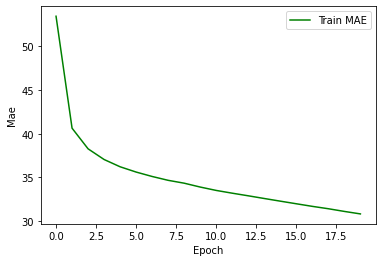

train all mae: 30.45968246459961
test      mae: 36.19908905029297


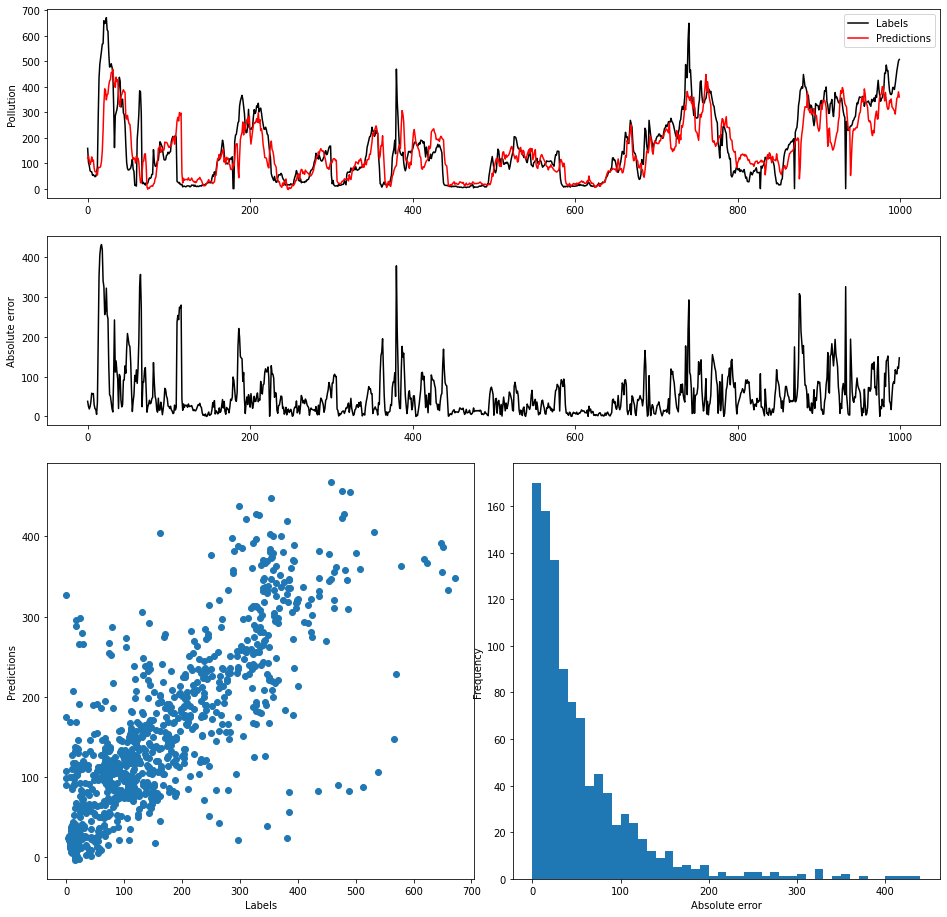

In [22]:
plot_history(history)

# y_train = model.predict(X_train_w)
# y_val = model.predict(X_val_w)
y_train_all = model.predict(X_train_all_w)
y_test = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train)
# mae_val = mean_absolute_error(r_val_w,y_val)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all)
mae_test = mean_absolute_error(r_test_w,y_test)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

# Visualise first 1000 predictions for validation and test
# PlotResults(r_val_w[:1000],y_val[:1000,0])
PlotResults(r_test_w[:1000],y_test[:1000,0])

# Step 4

## Models

In [0]:
def conv_model(CNN_WINDOW_SIZE=24, learning_rate=0.01, hidden=[32,64,128,256], n_features=16):
  model = Sequential()

  model.add(Conv1D(filters=hidden[0],
                   kernel_size=2,
                   padding='same',
                   kernel_initializer='he_uniform',
                   input_shape=(CNN_WINDOW_SIZE,n_features)))
  # model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling1D(pool_size=2))

  for idx in range(1, len(hidden)):
    model.add(Conv1D(filters=hidden[idx],
                     kernel_size=2,
                     padding='same',
                     kernel_initializer='he_uniform'))
    # model.add(BatchNormalization())
    model.add(Activation('relu'))
    model.add(MaxPooling1D(pool_size=2))

  model.add(Flatten())
  model.add(Dense(1, kernel_initializer='glorot_uniform'))
  model.add(Activation('linear'))

  optim = tf.keras.optimizers.Adam(learning_rate=learning_rate)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])

  return model

In [0]:
batch_size = 24
epochs = 20
learning_rate = 0.0001
CNN_WINDOW_SIZE = 2*168 # 2 weeks
ahead = 6

In [25]:
# 1
train_features = np.arange(16) # 16: all

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256], n_features=len(train_features))
# model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w, r_train_all_w, shuffle=True, batch_size=batch_size, epochs=epochs)

# y_train_1 = model.predict(X_train_w)
# y_val_1 = model.predict(X_val_w)
y_train_all_1 = model.predict(X_train_all_w)
y_test_1 = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train_1)
# mae_val = mean_absolute_error(r_val_w,y_val_1)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all_1)
mae_test = mean_absolute_error(r_test_w,y_test_1)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 7s 203us/sample - loss: 54.8534 - mse: 6857.3096 - mae: 54.8535
Epoch 2/20
34699/34699 [==============================] - 6s 187us/sample - loss: 40.8519 - mse: 3880.9929 - mae: 40.8518
Epoch 3/20
34699/34699 [==============================] - 7s 197us/sample - loss: 38.1572 - mse: 3535.9573 - mae: 38.1571
Epoch 4/20
34699/34699 [==============================] - 7s 207us/sample - loss: 36.9534 - mse: 3386.5479 - mae: 36.9534
Epoch 5/20
34699/34699 [==============================] - 7s 194us/sample - loss: 36.1111 - mse: 3287.3606 - mae: 36.1111
Epoch 6/20
34699/34699 [==============================] - 7s 196us/sample - loss: 35.4299 - mse: 3210.5422 - mae: 35.4299
Epoch 7/20
34699/34699 [==============================] - 7s 199us/sample - loss: 34.9252 - mse: 3159.7725 - mae: 34.9252
Epoch 8/20
34699/34699 [==============================] - 7s 202us/sample - loss: 34.4660 - mse: 3102.1282 - mae: 34.4660
E

In [26]:
# 2
train_features = np.arange(14) # 14: without snow and rain

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256], n_features=len(train_features))
# model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w, r_train_all_w, shuffle=True, batch_size=batch_size, epochs=epochs)

# y_train_2 = model.predict(X_train_w)
# y_val_2 = model.predict(X_val_w)
y_train_all_2 = model.predict(X_train_all_w)
y_test_2 = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train_2)
# mae_val = mean_absolute_error(r_val_w,y_val_2)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all_2)
mae_test = mean_absolute_error(r_test_w,y_test_2)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 7s 212us/sample - loss: 52.8202 - mse: 6273.0283 - mae: 52.8202
Epoch 2/20
34699/34699 [==============================] - 7s 197us/sample - loss: 40.0717 - mse: 3761.2554 - mae: 40.0717
Epoch 3/20
34699/34699 [==============================] - 7s 199us/sample - loss: 37.8851 - mse: 3519.9519 - mae: 37.8851
Epoch 4/20
34699/34699 [==============================] - 7s 196us/sample - loss: 36.8386 - mse: 3413.6392 - mae: 36.8386
Epoch 5/20
34699/34699 [==============================] - 7s 194us/sample - loss: 36.1003 - mse: 3347.7534 - mae: 36.1004
Epoch 6/20
34699/34699 [==============================] - 7s 193us/sample - loss: 35.4671 - mse: 3277.6780 - mae: 35.4671
Epoch 7/20
34699/34699 [==============================] - 7s 195us/sample - loss: 34.9650 - mse: 3222.1902 - mae: 34.9650
Epoch 8/20
34699/34699 [==============================] - 7s 197us/sample - loss: 34.4782 - mse: 3171.0457 - mae: 34.4783
E

In [27]:
# 3
train_features = np.arange(13) # 13: also leave pressure out

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256], n_features=len(train_features))
# model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w, r_train_all_w, shuffle=True, batch_size=batch_size, epochs=epochs)

# y_train_3 = model.predict(X_train_w)
# y_val_3 = model.predict(X_val_w)
y_train_all_3 = model.predict(X_train_all_w)
y_test_3 = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train_3)
# mae_val = mean_absolute_error(r_val_w,y_val_3)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all_3)
mae_test = mean_absolute_error(r_test_w,y_test_3)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 7s 210us/sample - loss: 54.0307 - mse: 6617.4917 - mae: 54.0307
Epoch 2/20
34699/34699 [==============================] - 7s 190us/sample - loss: 40.2426 - mse: 3807.7834 - mae: 40.2426
Epoch 3/20
34699/34699 [==============================] - 7s 191us/sample - loss: 37.9463 - mse: 3515.8484 - mae: 37.9462
Epoch 4/20
34699/34699 [==============================] - 7s 191us/sample - loss: 36.8989 - mse: 3408.2424 - mae: 36.8989
Epoch 5/20
34699/34699 [==============================] - 7s 191us/sample - loss: 36.1279 - mse: 3325.7302 - mae: 36.1279
Epoch 6/20
34699/34699 [==============================] - 7s 193us/sample - loss: 35.6114 - mse: 3265.9702 - mae: 35.6114
Epoch 7/20
34699/34699 [==============================] - 7s 196us/sample - loss: 35.1045 - mse: 3212.6860 - mae: 35.1044
Epoch 8/20
34699/34699 [==============================] - 7s 191us/sample - loss: 34.7127 - mse: 3173.8320 - mae: 34.7126
E

In [28]:
# 4
train_features = np.arange(12) # 12: also leave temperature out

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256], n_features=len(train_features))
# model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w, r_train_all_w, shuffle=True, batch_size=batch_size, epochs=epochs)

# y_train_4 = model.predict(X_train_w)
# y_val_4 = model.predict(X_val_w)
y_train_all_4 = model.predict(X_train_all_w)
y_test_4 = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train_4)
# mae_val = mean_absolute_error(r_val_w,y_val_4)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all_4)
mae_test = mean_absolute_error(r_test_w,y_test_4)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 7s 207us/sample - loss: 52.7946 - mse: 6387.0820 - mae: 52.7945
Epoch 2/20
34699/34699 [==============================] - 7s 190us/sample - loss: 40.1069 - mse: 3812.5237 - mae: 40.1069
Epoch 3/20
34699/34699 [==============================] - 7s 190us/sample - loss: 37.9810 - mse: 3552.3857 - mae: 37.9810
Epoch 4/20
34699/34699 [==============================] - 7s 191us/sample - loss: 37.0116 - mse: 3439.1738 - mae: 37.0116
Epoch 5/20
34699/34699 [==============================] - 7s 189us/sample - loss: 36.3666 - mse: 3364.1562 - mae: 36.3666
Epoch 6/20
34699/34699 [==============================] - 7s 190us/sample - loss: 35.8381 - mse: 3306.1174 - mae: 35.8381
Epoch 7/20
34699/34699 [==============================] - 7s 194us/sample - loss: 35.4023 - mse: 3251.7136 - mae: 35.4023
Epoch 8/20
34699/34699 [==============================] - 7s 190us/sample - loss: 34.9676 - mse: 3201.4102 - mae: 34.9676
E

In [29]:
# 5
train_features = [0,] # only pollution

# X_train_w,r_train_w = create_dataset_windowed(train_scaled[:,train_features], train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_w,r_val_w = create_dataset_windowed(val_scaled[:,train_features], val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_w,r_train_all_w = create_dataset_windowed(train_all_scaled[:,train_features],train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_w,r_test_w = create_dataset_windowed(test_scaled[:,train_features],test_labels, window_size=CNN_WINDOW_SIZE)

model = conv_model(CNN_WINDOW_SIZE=CNN_WINDOW_SIZE, learning_rate=learning_rate, hidden=[32,64,128,256], n_features=len(train_features))
# model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_w, r_train_w,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_w,r_val_w),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_w, r_train_all_w, shuffle=True, batch_size=batch_size, epochs=epochs)

# y_train_5 = model.predict(X_train_w)
# y_val_5 = model.predict(X_val_w)
y_train_all_5 = model.predict(X_train_all_w)
y_test_5 = model.predict(X_test_w)

# mae_train = mean_absolute_error(r_train_w,y_train_5)
# mae_val = mean_absolute_error(r_val_w,y_val_5)
mae_train_all = mean_absolute_error(r_train_all_w,y_train_all_5)
mae_test = mean_absolute_error(r_test_w,y_test_5)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 7s 190us/sample - loss: 50.5201 - mse: 5662.3936 - mae: 50.5200
Epoch 2/20
34699/34699 [==============================] - 6s 172us/sample - loss: 41.0793 - mse: 3996.4307 - mae: 41.0793
Epoch 3/20
34699/34699 [==============================] - 6s 170us/sample - loss: 39.6769 - mse: 3839.4705 - mae: 39.6769
Epoch 4/20
34699/34699 [==============================] - 6s 173us/sample - loss: 38.8301 - mse: 3750.6023 - mae: 38.8301
Epoch 5/20
34699/34699 [==============================] - 6s 172us/sample - loss: 38.3320 - mse: 3694.9348 - mae: 38.3320
Epoch 6/20
34699/34699 [==============================] - 6s 169us/sample - loss: 38.0554 - mse: 3672.5378 - mae: 38.0554
Epoch 7/20
34699/34699 [==============================] - 6s 172us/sample - loss: 37.7645 - mse: 3641.6311 - mae: 37.7645
Epoch 8/20
34699/34699 [==============================] - 6s 170us/sample - loss: 37.5976 - mse: 3621.0688 - mae: 37.5977
E

## Average

train all mae: 29.714717864990234
test      mae: 34.52711868286133


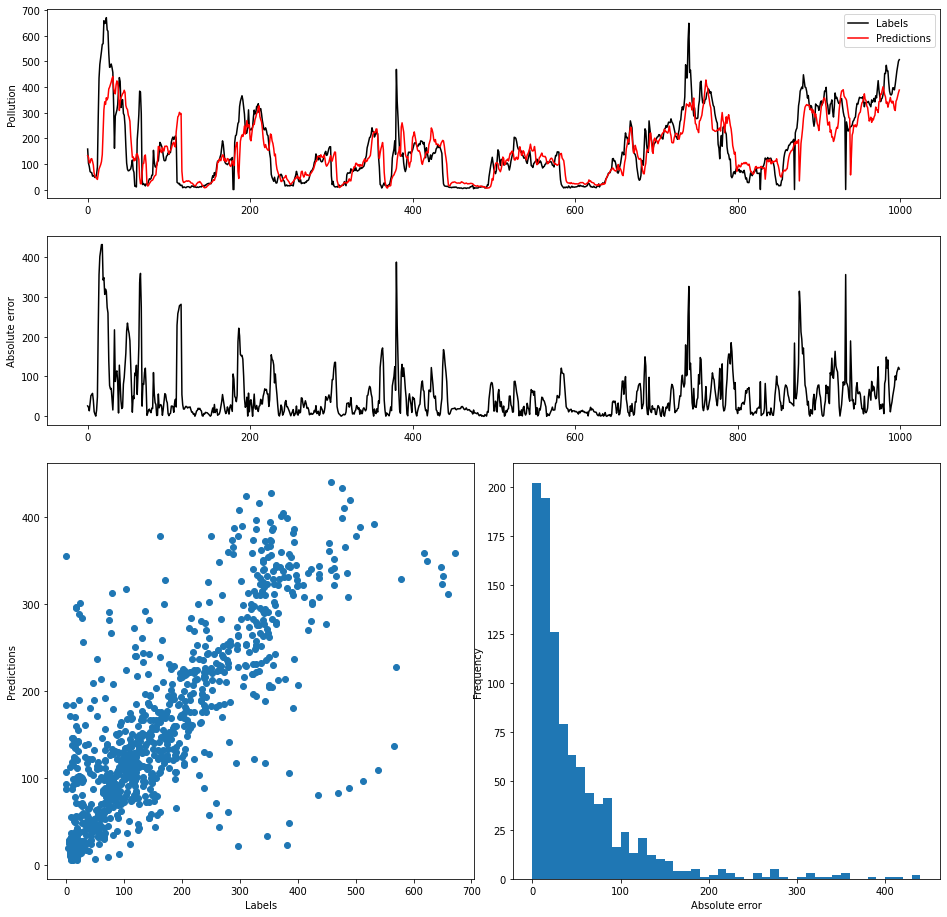

In [30]:
# create new dataset
# X_train_t,r_train_t = create_dataset_top((y_train_1, y_train_2, y_train_3, y_train_4, y_train_5), train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_t,r_val_t = create_dataset_top((y_val_1, y_val_2, y_val_3, y_val_4, y_val_5), val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_t,r_train_all_t = create_dataset_top((y_train_all_1, y_train_all_2, y_train_all_3, y_train_all_4, y_train_all_5), train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_t,r_test_t = create_dataset_top((y_test_1, y_test_2, y_test_3, y_test_4, y_test_5), test_labels, window_size=CNN_WINDOW_SIZE)

# y_train = np.mean(X_train_t, axis=1)
# y_val = np.mean(X_val_t, axis=1)
y_train_all = np.mean(X_train_all_t, axis=1)
y_test = np.mean(X_test_t, axis=1)

# mae_train = mean_absolute_error(r_train_t,y_train)
# mae_val = mean_absolute_error(r_val_t,y_val)
mae_train_all = mean_absolute_error(r_train_all_t,y_train_all)
mae_test = mean_absolute_error(r_test_t,y_test)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

# Visualise first 1000 predictions for test
# PlotResults(r_val_t[:1000],y_val[:1000])
PlotResults(r_test_t[:1000],y_test[:1000])

## Weighted average

In [0]:
# create new dataset
# X_train_t,r_train_t = create_dataset_top((y_train_1, y_train_2, y_train_3, y_train_4, y_train_5), train_labels, window_size=CNN_WINDOW_SIZE)
# X_val_t,r_val_t = create_dataset_top((y_val_1, y_val_2, y_val_3, y_val_4, y_val_5), val_labels, window_size=CNN_WINDOW_SIZE)
X_train_all_t,r_train_all_t = create_dataset_top((y_train_all_1, y_train_all_2, y_train_all_3, y_train_all_4, y_train_all_5), train_all_labels, window_size=CNN_WINDOW_SIZE)
X_test_t,r_test_t = create_dataset_top((y_test_1, y_test_2, y_test_3, y_test_4, y_test_5), test_labels, window_size=CNN_WINDOW_SIZE)

def top_model(n_models=5, learning_rate=0.01):
  model = Sequential(Dense(1, activation='linear', kernel_initializer=tf.constant_initializer(value=1/n_models), kernel_constraint=tf.keras.constraints.MaxNorm(), use_bias=False, input_shape=(n_models,)))

  optim = tf.keras.optimizers.Adam(learning_rate=learning_rate)
  model.compile(loss='mae',
                optimizer=optim,
                # keep extra metrics: mse and mae without regularisation terms
                metrics=['mse', 'mae'])
  
  return model

In [32]:
batch_size = 32
epochs = 20
learning_rate = 0.001

model = top_model(n_models=5, learning_rate=learning_rate)
model.summary()

# cp_path = '/content/gdrive/My Drive/Colab Notebooks/DL2020/GA3/checkpoints/step_4/cp.ckpt'
# cp_callback = tf.keras.callbacks.ModelCheckpoint(cp_path,
#                                                  monitor='val_mae',
#                                                  verbose=1,
#                                                  save_best_only=True,
#                                                  save_weights_only=True)

# history = model.fit(X_train_t, r_train_t,
#                     shuffle=True,
#                     batch_size=batch_size,
#                     epochs=epochs,
#                     validation_data=(X_val_t,r_val_t),
#                     callbacks=[cp_callback])
# model.load_weights(cp_path)

history = model.fit(X_train_all_t, r_train_all_t, shuffle=True, batch_size=batch_size, epochs=epochs)

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 1)                 5         
Total params: 5
Trainable params: 5
Non-trainable params: 0
_________________________________________________________________
Train on 34699 samples
Epoch 1/20
34699/34699 [==============================] - 3s 89us/sample - loss: 29.5108 - mse: 2583.5007 - mae: 29.5108
Epoch 2/20
34699/34699 [==============================] - 3s 85us/sample - loss: 29.2769 - mse: 2557.5396 - mae: 29.2769
Epoch 3/20
34699/34699 [==============================] - 3s 82us/sample - loss: 29.1851 - mse: 2542.3557 - mae: 29.1851
Epoch 4/20
34699/34699 [==============================] - 3s 83us/sample - loss: 29.1535 - mse: 2533.5254 - mae: 29.1535
Epoch 5/20
34699/34699 [==============================] - 3s 83us/sample - loss: 29.1325 - mse: 2534.1399 - mae: 29.1325
Epoch 6/20
34699/34699 [==

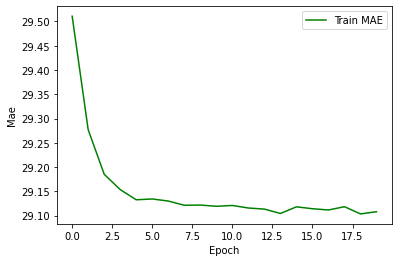

train all mae: 29.08261489868164
test      mae: 35.12261962890625


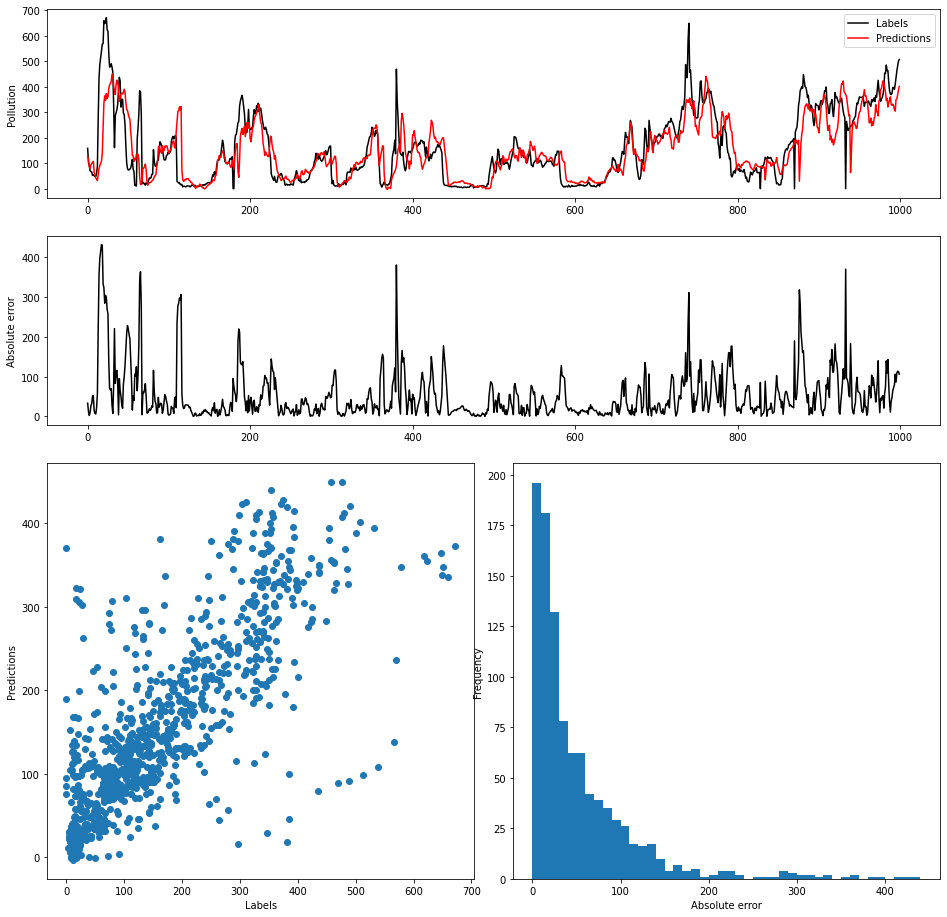

In [33]:
plot_history(history)

# y_train = model.predict(X_train_t)
# y_val = model.predict(X_val_t)
y_train_all = model.predict(X_train_all_t)
y_test = model.predict(X_test_t)

# mae_train = mean_absolute_error(r_train_t,y_train)
# mae_val = mean_absolute_error(r_val_t,y_val)
mae_train_all = mean_absolute_error(r_train_all_t,y_train_all)
mae_test = mean_absolute_error(r_test_t,y_test)

# print(f"train      mae: {mae_train}")
# print(f"validation mae: {mae_val}")
print(f"train all mae: {mae_train_all}")
print(f"test      mae: {mae_test}")

# Visualise first 1000 predictions for test
# PlotResults(r_val_t[:1000],y_val[:1000,0])
PlotResults(r_test_t[:1000],y_test[:1000,0])

In [34]:
# get weights of each model
model.layers[0].get_weights()

[array([[ 0.31255028],
        [ 0.34277973],
        [ 0.34602535],
        [ 0.06957645],
        [-0.08152214]], dtype=float32)]